In [2]:
import pandas as pd
import numpy as np
from scipy import signal
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier 
from pykalman import KalmanFilter
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score,classification_report

In [5]:
pd.set_option("max_row",None)
pd.set_option("max_column",None)

In [6]:
df_sensor_train = pd.read_csv('sensor_train.csv')

In [7]:
df_sensor_train.head()

,fragment_id,time_point,acc_x,acc_y,acc_z,acc_xg,acc_yg,acc_zg,behavior_id
0,0,27,0.3,-0.3,0.1,0.6,4.5,8.8,0
1,0,108,0.1,-0.0,-0.4,0.4,4.7,8.4,0
2,0,198,0.1,0.0,0.3,0.9,4.6,9.0,0
3,0,297,0.1,-0.1,-0.5,0.8,4.7,7.2,0
4,0,388,0.1,0.2,0.6,0.9,4.7,8.9,0


In [8]:
groups = df_sensor_train['fragment_id'].value_counts()
len(groups)


7292

In [9]:
behavior = df_sensor_train['behavior_id'].value_counts()
len(behavior)

19

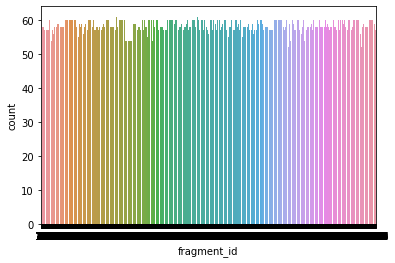

In [10]:
ax = sns.countplot(x="fragment_id", data=df_sensor_train)

In [11]:
df_sensor_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 425359 entries, 0 to 425358
Data columns (total 9 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   fragment_id  425359 non-null  int64  
 1   time_point   425359 non-null  int64  
 2   acc_x        425359 non-null  float64
 3   acc_y        425359 non-null  float64
 4   acc_z        425359 non-null  float64
 5   acc_xg       425359 non-null  float64
 6   acc_yg       425359 non-null  float64
 7   acc_zg       425359 non-null  float64
 8   behavior_id  425359 non-null  int64  
dtypes: float64(6), int64(3)
memory usage: 29.2 MB


In [12]:
df_sensor_train.nunique()

fragment_id    7292
time_point     5000
acc_x           212
acc_y           159
acc_z           218
acc_xg          300
acc_yg          272
acc_zg          284
behavior_id      19
dtype: int64

In [13]:
summary = df_sensor_train.describe()
summary[['time_point','acc_x','acc_y','acc_z','acc_xg','acc_yg','acc_zg']]

,time_point,acc_x,acc_y,acc_z,acc_xg,acc_yg,acc_zg
count,425359.000000,425359.000000,425359.000000,425359.000000,425359.000000,425359.000000,425359.000000
mean,2500.952026,0.009635,-0.063114,0.024548,0.965656,2.730190,7.825065
std,1442.307956,0.619285,0.537614,0.717009,3.295531,2.978134,2.653261
min,0.000000,-14.700000,-14.700000,-12.600000,-19.800000,-16.900000,-8.900000
25%,1252.000000,-0.100000,-0.100000,-0.200000,-0.700000,0.400000,7.300000
50%,2501.000000,0.000000,0.000000,0.000000,0.200000,2.700000,8.700000
75%,3749.000000,0.100000,0.100000,0.200000,2.000000,4.900000,9.400000
max,4999.000000,34.500000,13.400000,28.200000,30.200000,14.400000,38.100000


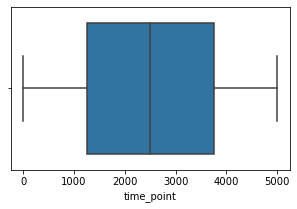

In [14]:
df_sensor_train["time_point"].describe()
plt.figure(figsize = [5,3])
sns.boxplot(df_sensor_train['time_point'])

In [15]:
df_sensor_train["acc_x"].describe()

count    425359.000000
mean          0.009635
std           0.619285
min         -14.700000
25%          -0.100000
50%           0.000000
75%           0.100000
max          34.500000
Name: acc_x, dtype: float64

In [16]:
df_sensor_train['acc_y'].describe()

count    425359.000000
mean         -0.063114
std           0.537614
min         -14.700000
25%          -0.100000
50%           0.000000
75%           0.100000
max          13.400000
Name: acc_y, dtype: float64

In [17]:
df_sensor_train['acc_z'].describe()

count    425359.000000
mean          0.024548
std           0.717009
min         -12.600000
25%          -0.200000
50%           0.000000
75%           0.200000
max          28.200000
Name: acc_z, dtype: float64

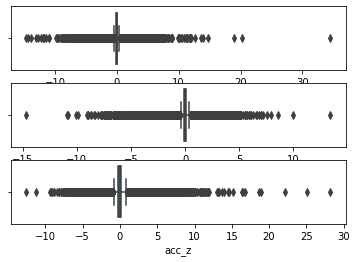

In [18]:
plt.subplot(3, 1, 1)
sns.boxplot(df_sensor_train['acc_x'])
plt.subplot(3, 1, 2)
sns.boxplot(df_sensor_train['acc_y'])
plt.subplot(3, 1, 3)
sns.boxplot(df_sensor_train['acc_z'])

In [19]:
df_sensor_train = df_sensor_train.sort_values(['fragment_id','time_point'])

In [20]:
df_sensor_train.head()

,fragment_id,time_point,acc_x,acc_y,acc_z,acc_xg,acc_yg,acc_zg,behavior_id
0,0,27,0.3,-0.3,0.1,0.6,4.5,8.8,0
1,0,108,0.1,-0.0,-0.4,0.4,4.7,8.4,0
2,0,198,0.1,0.0,0.3,0.9,4.6,9.0,0
3,0,297,0.1,-0.1,-0.5,0.8,4.7,7.2,0
4,0,388,0.1,0.2,0.6,0.9,4.7,8.9,0


In [21]:
df_sensor_train['rnk'] = 1
df_sensor_train['rnk'] = df_sensor_train.groupby(['fragment_id'])['rnk'].transform('cumsum')

In [22]:
df_sensor_train.head()

,fragment_id,time_point,acc_x,acc_y,acc_z,acc_xg,acc_yg,acc_zg,behavior_id,rnk
0,0,27,0.3,-0.3,0.1,0.6,4.5,8.8,0,1
1,0,108,0.1,-0.0,-0.4,0.4,4.7,8.4,0,2
2,0,198,0.1,0.0,0.3,0.9,4.6,9.0,0,3
3,0,297,0.1,-0.1,-0.5,0.8,4.7,7.2,0,4
4,0,388,0.1,0.2,0.6,0.9,4.7,8.9,0,5


In [23]:
df_label = df_sensor_train.drop_duplicates(subset=['fragment_id']).reset_index(drop=True)[['fragment_id', 'behavior_id']]

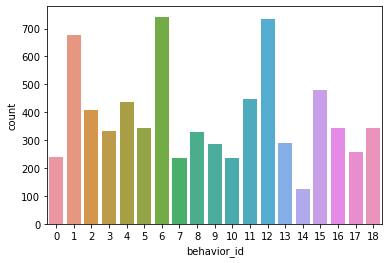

In [24]:
ax = sns.countplot(x="behavior_id", data=df_label)

Use Kalman filter to clean the noise

In [4]:
df = pd.read_csv('sensor_train.csv')
data = df.values
df_test = pd.read_csv('sensor_test.csv')
data_test = df_test.values

In [5]:
datax = data[:, :-1]
datay = data[:, -1]

In [6]:
def Kalman1D(observations,damping=1):
    # To return the smoothed time series data
    observation_covariance = damping
    initial_value_guess = observations[0]
    transition_matrix = 1
    transition_covariance = 0.1
    initial_value_guess
    kf = KalmanFilter(
            initial_state_mean=initial_value_guess,
            initial_state_covariance=observation_covariance,
            observation_covariance=observation_covariance,
            transition_covariance=transition_covariance,
            transition_matrices=transition_matrix
        )
    pred_state, state_cov = kf.smooth(observations)
    return pred_state

In [45]:
#These processes will take a while, since the data is large

for i in range(datax.shape[1]-1):
    df.loc[:,i] = Kalman1D(datax[:,i],0.01)
datax = df.values

for i in range(data_test.shape[1]-1):
    df_test.loc[:,i] = Kalman1D(data_test[:,i],0.01)
data_test = df_test.values


A simple RFC model

In [9]:
xtrain, xtest, ytrain, ytest = train_test_split(datax, datay, test_size=0.2)

rfc = RandomForestClassifier()                  
rfc = rfc.fit(xtrain,ytrain)                     
result = rfc.score(xtest,ytest)
test_result = rfc.predict(data_test)
print(result)


0.9988950536016551


In [8]:
print(test_result)

[ 0.  0.  0. ... 18. 18. 17.]


Extract data features, model and analyze the impact of features on modeling results

In [79]:
origin_fea_cols = ['acc_x','acc_y','acc_z','acc_xg','acc_yg','acc_zg']

In [80]:
from tqdm import tqdm
from sklearn.metrics import accuracy_score,classification_report

In [81]:
def get_dic(df,  main_col, fea_col, agg):
    dic = df.groupby(main_col)[fea_col].agg(agg).to_dict()
    fea_name = '_'.join([main_col, fea_col, agg])
    print(fea_name)
    return fea_name, dic
    
def get_1st_order_xyz_features(df, fea_cols, main_col = 'fragment_id'): 
    df_fea           = pd.DataFrame()
    df_fea[main_col] = df[main_col].unique()
    
    
    #Count each features
    _,dic = get_dic(df, main_col, fea_cols[0], 'count') 

    df_fea['count']    = df_fea[main_col].map(dic).values
    

    for f in tqdm(fea_cols):
        for agg in ['min','max','mean','std','skew','median']:

            fea_name, dic       = get_dic(df, main_col, f, agg) 
            df_fea[fea_name]    = df_fea[main_col].map(dic).values
            
        df_fea['_'.join([main_col, f, 'gap'])]   = df_fea['_'.join([main_col, f, 'max'])] - df_fea['_'.join([main_col, f, 'min'])]
        
        
    return df_fea

In [82]:
df_xyz_fea1 = get_1st_order_xyz_features(df_sensor_train,origin_fea_cols,main_col='fragment_id')

fragment_id_acc_x_count
fragment_id_acc_x_count


  0%|          | 0/6 [00:00<?, ?it/s]

fragment_id_acc_x_min
fragment_id_acc_x_max
fragment_id_acc_x_mean
fragment_id_acc_x_std


 17%|█▋        | 1/6 [00:01<00:07,  1.49s/it]

fragment_id_acc_x_skew
fragment_id_acc_x_median
fragment_id_acc_y_min
fragment_id_acc_y_max
fragment_id_acc_y_mean
fragment_id_acc_y_std


 33%|███▎      | 2/6 [00:02<00:05,  1.48s/it]

fragment_id_acc_y_skew
fragment_id_acc_y_median
fragment_id_acc_z_min
fragment_id_acc_z_max
fragment_id_acc_z_mean
fragment_id_acc_z_std


 50%|█████     | 3/6 [00:04<00:04,  1.46s/it]

fragment_id_acc_z_skew
fragment_id_acc_z_median
fragment_id_acc_xg_min
fragment_id_acc_xg_max
fragment_id_acc_xg_mean
fragment_id_acc_xg_std


 67%|██████▋   | 4/6 [00:05<00:02,  1.45s/it]

fragment_id_acc_xg_skew
fragment_id_acc_xg_median
fragment_id_acc_yg_min
fragment_id_acc_yg_max
fragment_id_acc_yg_mean
fragment_id_acc_yg_std


 83%|████████▎ | 5/6 [00:07<00:01,  1.44s/it]

fragment_id_acc_yg_skew
fragment_id_acc_yg_median
fragment_id_acc_zg_min
fragment_id_acc_zg_max
fragment_id_acc_zg_mean
fragment_id_acc_zg_std


100%|██████████| 6/6 [00:08<00:00,  1.44s/it]

fragment_id_acc_zg_skew
fragment_id_acc_zg_median


In [83]:
df_xyz_fea1

,fragment_id,count,fragment_id_acc_x_min,fragment_id_acc_x_max,fragment_id_acc_x_mean,fragment_id_acc_x_std,fragment_id_acc_x_skew,fragment_id_acc_x_median,fragment_id_acc_x_gap,fragment_id_acc_y_min,fragment_id_acc_y_max,fragment_id_acc_y_mean,fragment_id_acc_y_std,fragment_id_acc_y_skew,fragment_id_acc_y_median,fragment_id_acc_y_gap,fragment_id_acc_z_min,fragment_id_acc_z_max,fragment_id_acc_z_mean,fragment_id_acc_z_std,fragment_id_acc_z_skew,fragment_id_acc_z_median,fragment_id_acc_z_gap,fragment_id_acc_xg_min,fragment_id_acc_xg_max,fragment_id_acc_xg_mean,fragment_id_acc_xg_std,fragment_id_acc_xg_skew,fragment_id_acc_xg_median,fragment_id_acc_xg_gap,fragment_id_acc_yg_min,fragment_id_acc_yg_max,fragment_id_acc_yg_mean,fragment_id_acc_yg_std,fragment_id_acc_yg_skew,fragment_id_acc_yg_median,fragment_id_acc_yg_gap,fragment_id_acc_zg_min,fragment_id_acc_zg_max,fragment_id_acc_zg_mean,fragment_id_acc_zg_std,fragment_id_acc_zg_skew,fragment_id_acc_zg_median,fragment_id_acc_zg_gap
0,0,57,-0.9,0.4,-1.754386e-03,0.194102,-1.523203,0.00,1.3,-0.3,0.2,-1.754386e-03,0.085547,-0.497876,-0.00,0.5,-0.8,0.7,3.508772e-03,0.294573,-0.283199,-0.00,1.5,-0.2,1.3,6.771930e-01,0.200016,-0.909003,0.70,1.5,4.4,5.2,4.773684e+00,0.158707,0.284234,4.80,0.8,7.2,9.3,8.508772,0.338738,-0.746650,8.50,2.1
1,1,56,-0.5,0.2,-2.500000e-02,0.109959,-1.350853,-0.00,0.7,-0.1,0.2,2.678571e-02,0.058748,0.434311,0.00,0.3,-0.5,0.6,7.857143e-02,0.184602,0.129004,0.10,1.1,0.4,1.0,6.785714e-01,0.126080,-0.199871,0.70,0.6,4.6,5.1,4.830357e+00,0.123465,0.411559,4.80,0.5,8.1,9.4,8.519643,0.241525,0.917398,8.50,1.3
2,2,57,-0.5,0.7,-2.807018e-02,0.239609,0.489693,-0.00,1.2,-0.6,0.2,-5.263158e-03,0.136828,-1.635879,0.00,0.8,-1.3,1.2,2.456140e-02,0.396989,-0.770588,0.00,2.5,0.2,1.8,7.929825e-01,0.339569,0.853589,0.70,1.6,4.4,5.4,4.952632e+00,0.234601,-0.081638,4.90,1.0,7.2,9.8,8.394737,0.433186,-0.103604,8.40,2.6
3,3,55,-0.4,0.5,1.818182e-03,0.178980,0.072280,0.00,0.9,-0.3,0.4,2.363636e-02,0.121661,1.126930,-0.00,0.7,-0.8,1.7,9.454545e-02,0.496438,1.413450,0.00,2.5,-0.6,1.2,4.109091e-01,0.319532,-0.555181,0.40,1.8,4.5,5.5,5.049091e+00,0.196141,-0.054651,5.00,1.0,7.5,9.5,8.340000,0.414371,0.472631,8.30,2.0
4,4,55,-1.3,0.9,1.818182e-03,0.338018,-0.762639,0.00,2.2,-0.5,0.6,3.636364e-03,0.192415,0.464490,0.00,1.1,-1.7,1.8,2.363636e-02,0.705787,-0.013071,0.10,3.5,-0.5,1.5,6.090909e-01,0.419114,-0.127315,0.70,2.0,3.7,5.3,4.645455e+00,0.296784,-0.382833,4.70,1.6,5.8,10.4,8.558182,0.753434,-0.615809,8.60,4.6
5,5,55,-1.4,0.6,-1.090909e-02,0.339211,-1.267623,-0.00,2.0,-0.2,0.7,5.454545e-02,0.185411,1.155672,-0.00,0.9,-1.8,2.1,1.090909e-01,0.768180,0.171691,0.10,3.9,-0.8,1.4,5.436364e-01,0.407687,-1.609031,0.60,2.2,4.3,6.0,4.787273e+00,0.294426,1.349161,4.80,1.7,7.2,9.8,8.529091,0.585843,-0.194480,8.60,2.6
6,6,57,-1.8,0.8,-2.807018e-02,0.413933,-1.753154,0.00,2.6,-1.6,0.8,7.017544e-03,0.374099,-1.441851,0.00,2.4,-3.0,2.5,4.035088e-02,0.835990,-0.991008,0.10,5.5,-1.4,1.5,2.929825e-01,0.593073,-1.067541,0.40,2.9,4.0,8.2,5.305263e+00,0.855950,1.771265,5.00,4.2,1.4,10.0,8.240351,1.346670,-3.592750,8.50,8.6
7,7,57,-0.4,0.7,1.754386e-02,0.249373,0.737990,0.00,1.1,-0.6,0.6,7.017544e-03,0.226668,0.148435,-0.00,1.2,-2.5,2.0,-1.052632e-02,0.682873,0.176252,-0.00,4.5,-1.0,1.1,1.017544e-01,0.386140,-0.619384,0.10,2.1,4.9,5.9,5.236842e+00,0.204093,0.928080,5.20,1.0,6.7,9.6,8.168421,0.600047,-0.253549,8.20,2.9
8,8,58,-0.8,0.4,-8.620690e-03,0.172987,-1.315785,-0.00,1.2,-0.2,0.6,1.896552e-02,0.105060,2.801863,-0.00,0.8,-1.2,1.5,6.896552e-03,0.332910,0.531521,0.00,2.7,-0.1,0.8,2.982759e-01,0.179171,0.595378,0.30,0.9,4.7,5.4,5.058621e+00,0.119992,-0.715309,5.10,0.7,7.2,9.2,8.350000,0.317474,-0.575811,8.35,2.0
9,9,55,-0.4,0.3,-9.090909e-03,0.192712,-0.269223,-0.00,0.7,-0.6,0.2,-1.818182e-02,0.130655,-1.717971,-0.00,0.8,-1.2,1.5,-7.272727e-03,0.443828,0.253245,-0.00,2.7,-0.3,1.3,3.218182e-01,0.289758,0.878929,0.30,1.6,4.1,5.3,4.889091e+00,0.155959,-2.152740,4.90,1.2,6.3,9.6,8.489091,0.470096,-1.705809,8.50

In [84]:
df_tr_te = df_label.merge(df_xyz_fea1, on ='fragment_id', how = 'left')
label_feat = 'behavior_id'
train_df = df_tr_te[((df_tr_te[label_feat].isna()==False) & (df_tr_te[label_feat] >=0))].reset_index(drop=True)
test_df  = df_tr_te[((df_tr_te[label_feat].isna()==True) | (df_tr_te[label_feat] < 0))].reset_index(drop=True)

drop_feat = []
used_feat = [f for f in train_df.columns if f not in (['fragment_id', label_feat] + drop_feat)]
print(len(used_feat))
print(used_feat)


train_x = train_df[used_feat]
train_y = train_df[label_feat]
test_x  = test_df[used_feat]

43
['count', 'fragment_id_acc_x_min', 'fragment_id_acc_x_max', 'fragment_id_acc_x_mean', 'fragment_id_acc_x_std', 'fragment_id_acc_x_skew', 'fragment_id_acc_x_median', 'fragment_id_acc_x_gap', 'fragment_id_acc_y_min', 'fragment_id_acc_y_max', 'fragment_id_acc_y_mean', 'fragment_id_acc_y_std', 'fragment_id_acc_y_skew', 'fragment_id_acc_y_median', 'fragment_id_acc_y_gap', 'fragment_id_acc_z_min', 'fragment_id_acc_z_max', 'fragment_id_acc_z_mean', 'fragment_id_acc_z_std', 'fragment_id_acc_z_skew', 'fragment_id_acc_z_median', 'fragment_id_acc_z_gap', 'fragment_id_acc_xg_min', 'fragment_id_acc_xg_max', 'fragment_id_acc_xg_mean', 'fragment_id_acc_xg_std', 'fragment_id_acc_xg_skew', 'fragment_id_acc_xg_median', 'fragment_id_acc_xg_gap', 'fragment_id_acc_yg_min', 'fragment_id_acc_yg_max', 'fragment_id_acc_yg_mean', 'fragment_id_acc_yg_std', 'fragment_id_acc_yg_skew', 'fragment_id_acc_yg_median', 'fragment_id_acc_yg_gap', 'fragment_id_acc_zg_min', 'fragment_id_acc_zg_max', 'fragment_id_acc_zg_m

In [85]:
rfc = RandomForestClassifier(n_estimators=200,max_depth=8,random_state=0)

In [86]:
train_x.describe()

,count,fragment_id_acc_x_min,fragment_id_acc_x_max,fragment_id_acc_x_mean,fragment_id_acc_x_std,fragment_id_acc_x_skew,fragment_id_acc_x_median,fragment_id_acc_x_gap,fragment_id_acc_y_min,fragment_id_acc_y_max,fragment_id_acc_y_mean,fragment_id_acc_y_std,fragment_id_acc_y_skew,fragment_id_acc_y_median,fragment_id_acc_y_gap,fragment_id_acc_z_min,fragment_id_acc_z_max,fragment_id_acc_z_mean,fragment_id_acc_z_std,fragment_id_acc_z_skew,fragment_id_acc_z_median,fragment_id_acc_z_gap,fragment_id_acc_xg_min,fragment_id_acc_xg_max,fragment_id_acc_xg_mean,fragment_id_acc_xg_std,fragment_id_acc_xg_skew,fragment_id_acc_xg_median,fragment_id_acc_xg_gap,fragment_id_acc_yg_min,fragment_id_acc_yg_max,fragment_id_acc_yg_mean,fragment_id_acc_yg_std,fragment_id_acc_yg_skew,fragment_id_acc_yg_median,fragment_id_acc_yg_gap,fragment_id_acc_zg_min,fragment_id_acc_zg_max,fragment_id_acc_zg_mean,fragment_id_acc_zg_std,fragment_id_acc_zg_skew,fragment_id_acc_zg_median,fragment_id_acc_zg_gap
count,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000
mean,58.332282,-1.089770,1.093801,0.009760,0.414330,-0.050999,0.011917,2.183571,-0.968116,0.763796,-0.063616,0.346982,-0.146058,-0.049328,1.731912,-1.298711,1.550096,0.024879,0.517539,0.120842,0.010244,2.848807,-0.473834,2.360354,0.964545,0.626919,-0.048435,0.972010,2.834188,1.499589,3.894103,2.731273,0.560066,-0.005852,2.748697,2.394515,6.275878,9.536506,7.821826,0.650548,0.046018,7.805595,3.260628
std,1.668028,1.264881,1.372823,0.111432,0.456825,1.063507,0.117362,2.448007,1.160768,0.889527,0.154575,0.389698,1.045116,0.156383,1.934678,1.228260,1.822820,0.098622,0.499637,0.909936,0.093438,2.868917,3.601729,3.500331,3.165626,0.696848,0.908438,3.191343,3.014991,3.390157,2.941286,2.842710,0.712019,0.905236,2.871531,2.770404,3.074735,2.895572,2.479293,0.698842,0.880038,2.529245,3.302555
min,50.000000,-14.700000,-0.000000,-1.200000,0.000000,-7.745967,-1.600000,0.000000,-14.700000,-0.100000,-1.663636,0.000000,-7.745967,-1.500000,0.000000,-12.600000,-0.000000,-1.513793,0.000000,-7.615773,-1.200000,0.000000,-19.800000,-8.600000,-9.294915,0.000000,-7.681146,-9.300000,0.000000,-16.900000,-6.300000,-8.475439,0.000000,-7.745967,-8.300000,0.000000,-8.900000,-3.500000,-4.020000,0.000000,-7.549834,-4.400000,0.000000
25%,57.000000,-1.400000,0.300000,-0.021667,0.112377,-0.421120,0.000000,0.600000,-1.300000,0.200000,-0.077193,0.083207,-0.490585,-0.100000,0.400000,-1.700000,0.500000,-0.015789,0.181501,-0.271809,0.000000,1.000000,-2.200000,0.300000,-0.615585,0.154657,-0.446790,-0.600000,0.800000,-0.400000,1.600000,0.460492,0.132012,-0.411975,0.400000,0.600000,5.500000,8.600000,7.506316,0.209170,-0.341273,7.550000,1.100000
50%,58.000000,-0.700000,0.700000,0.000000,0.256302,-0.022028,0.000000,1.400000,-0.500000,0.500000,-0.010526,0.183604,-0.094440,0.000000,1.000000,-0.900000,0.900000,0.005263,0.347615,0.097270,-0.000000,1.900000,-0.900000,1.400000,0.159661,0.403935,-0.051404,0.200000,1.900000,1.400000,3.900000,2.740000,0.314778,-0.022248,2.750000,1.400000,7.200000,9.800000,8.727828,0.412499,0.054757,8.700000,2.100000
75%,60.000000,-0.300000,1.400000,0.025862,0.572690,0.339331,0.000000,2.900000,-0.200000,1.000000,0.005000,0.486225,0.253313,0.000000,2.300000,-0.500000,1.900000,0.045000,0.636545,0.500745,0.000000,3.500000,0.500000,4.000000,1.716250,0.816301,0.321569,1.700000,3.600000,3.900000,5.900000,4.763470,0.661482,0.382468,4.800000,2.900000,8.300000,10.800000,9.333333,0.781073,0.460305,9.300000,4.000000
max,61.000000,0.300000,34.500000,1.694828,4.956934,7.745967,1.350000

In [89]:
train_x = train_x.replace(np.nan,0)
train_x = train_x.replace(np.inf,0)

In [90]:
train_x.describe()

,count,fragment_id_acc_x_min,fragment_id_acc_x_max,fragment_id_acc_x_mean,fragment_id_acc_x_std,fragment_id_acc_x_skew,fragment_id_acc_x_median,fragment_id_acc_x_gap,fragment_id_acc_y_min,fragment_id_acc_y_max,fragment_id_acc_y_mean,fragment_id_acc_y_std,fragment_id_acc_y_skew,fragment_id_acc_y_median,fragment_id_acc_y_gap,fragment_id_acc_z_min,fragment_id_acc_z_max,fragment_id_acc_z_mean,fragment_id_acc_z_std,fragment_id_acc_z_skew,fragment_id_acc_z_median,fragment_id_acc_z_gap,fragment_id_acc_xg_min,fragment_id_acc_xg_max,fragment_id_acc_xg_mean,fragment_id_acc_xg_std,fragment_id_acc_xg_skew,fragment_id_acc_xg_median,fragment_id_acc_xg_gap,fragment_id_acc_yg_min,fragment_id_acc_yg_max,fragment_id_acc_yg_mean,fragment_id_acc_yg_std,fragment_id_acc_yg_skew,fragment_id_acc_yg_median,fragment_id_acc_yg_gap,fragment_id_acc_zg_min,fragment_id_acc_zg_max,fragment_id_acc_zg_mean,fragment_id_acc_zg_std,fragment_id_acc_zg_skew,fragment_id_acc_zg_median,fragment_id_acc_zg_gap
count,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000,7292.000000
mean,58.332282,-1.089770,1.093801,0.009760,0.414330,-0.050999,0.011917,2.183571,-0.968116,0.763796,-0.063616,0.346982,-0.146058,-0.049328,1.731912,-1.298711,1.550096,0.024879,0.517539,0.120842,0.010244,2.848807,-0.473834,2.360354,0.964545,0.626919,-0.048435,0.972010,2.834188,1.499589,3.894103,2.731273,0.560066,-0.005852,2.748697,2.394515,6.275878,9.536506,7.821826,0.650548,0.046018,7.805595,3.260628
std,1.668028,1.264881,1.372823,0.111432,0.456825,1.063507,0.117362,2.448007,1.160768,0.889527,0.154575,0.389698,1.045116,0.156383,1.934678,1.228260,1.822820,0.098622,0.499637,0.909936,0.093438,2.868917,3.601729,3.500331,3.165626,0.696848,0.908438,3.191343,3.014991,3.390157,2.941286,2.842710,0.712019,0.905236,2.871531,2.770404,3.074735,2.895572,2.479293,0.698842,0.880038,2.529245,3.302555
min,50.000000,-14.700000,-0.000000,-1.200000,0.000000,-7.745967,-1.600000,0.000000,-14.700000,-0.100000,-1.663636,0.000000,-7.745967,-1.500000,0.000000,-12.600000,-0.000000,-1.513793,0.000000,-7.615773,-1.200000,0.000000,-19.800000,-8.600000,-9.294915,0.000000,-7.681146,-9.300000,0.000000,-16.900000,-6.300000,-8.475439,0.000000,-7.745967,-8.300000,0.000000,-8.900000,-3.500000,-4.020000,0.000000,-7.549834,-4.400000,0.000000
25%,57.000000,-1.400000,0.300000,-0.021667,0.112377,-0.421120,0.000000,0.600000,-1.300000,0.200000,-0.077193,0.083207,-0.490585,-0.100000,0.400000,-1.700000,0.500000,-0.015789,0.181501,-0.271809,0.000000,1.000000,-2.200000,0.300000,-0.615585,0.154657,-0.446790,-0.600000,0.800000,-0.400000,1.600000,0.460492,0.132012,-0.411975,0.400000,0.600000,5.500000,8.600000,7.506316,0.209170,-0.341273,7.550000,1.100000
50%,58.000000,-0.700000,0.700000,0.000000,0.256302,-0.022028,0.000000,1.400000,-0.500000,0.500000,-0.010526,0.183604,-0.094440,0.000000,1.000000,-0.900000,0.900000,0.005263,0.347615,0.097270,-0.000000,1.900000,-0.900000,1.400000,0.159661,0.403935,-0.051404,0.200000,1.900000,1.400000,3.900000,2.740000,0.314778,-0.022248,2.750000,1.400000,7.200000,9.800000,8.727828,0.412499,0.054757,8.700000,2.100000
75%,60.000000,-0.300000,1.400000,0.025862,0.572690,0.339331,0.000000,2.900000,-0.200000,1.000000,0.005000,0.486225,0.253313,0.000000,2.300000,-0.500000,1.900000,0.045000,0.636545,0.500745,0.000000,3.500000,0.500000,4.000000,1.716250,0.816301,0.321569,1.700000,3.600000,3.900000,5.900000,4.763470,0.661482,0.382468,4.800000,2.900000,8.300000,10.800000,9.333333,0.781073,0.460305,9.300000,4.000000
max,61.000000,0.300000,34.500000,1.694828,4.956934,7.745967,1.350000

In [91]:
train_y.describe()

count    7292.000000
mean        8.531679
std         5.399544
min         0.000000
25%         4.000000
50%         8.000000
75%        13.000000
max        18.000000
Name: behavior_id, dtype: float64

In [92]:
rfc = rfc.fit(train_x,train_y)

In [93]:
y_pred = rfc.predict(train_x)

In [94]:
print(classification_report(train_y, y_pred))

              precision    recall  f1-score   support

           0       0.56      0.64      0.60       241
           1       0.57      0.62      0.60       676
           2       0.73      0.82      0.77       409
           3       0.89      0.19      0.31       332
           4       0.89      0.91      0.90       435
           5       0.76      0.55      0.64       343
           6       0.44      0.75      0.56       742
           7       0.85      0.39      0.53       236
           8       0.73      0.74      0.73       328
           9       0.79      0.05      0.10       287
          10       0.57      0.72      0.64       236
          11       0.95      0.72      0.82       449
          12       0.50      0.98      0.66       734
          13       0.78      0.16      0.27       291
          14       0.00      0.00      0.00       126
          15       0.85      0.70      0.77       478
          16       0.69      0.97      0.81       345
          17       0.98    

C:\Users\Alexx\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [95]:
print(sorted(zip(map(lambda x: round(x, 4), rfc.feature_importances_), train_x.columns), reverse=True))

[(0.0621, 'fragment_id_acc_yg_min'), (0.0606, 'fragment_id_acc_yg_mean'), (0.0562, 'fragment_id_acc_yg_median'), (0.0557, 'fragment_id_acc_y_std'), (0.0448, 'fragment_id_acc_xg_mean'), (0.0435, 'fragment_id_acc_x_std'), (0.0407, 'fragment_id_acc_xg_median'), (0.0398, 'fragment_id_acc_zg_mean'), (0.0389, 'fragment_id_acc_yg_max'), (0.0377, 'fragment_id_acc_yg_std'), (0.0362, 'fragment_id_acc_zg_median'), (0.0347, 'fragment_id_acc_yg_gap'), (0.0341, 'fragment_id_acc_zg_min'), (0.0335, 'fragment_id_acc_xg_min'), (0.0324, 'fragment_id_acc_xg_max'), (0.0311, 'fragment_id_acc_y_gap'), (0.0306, 'fragment_id_acc_xg_std'), (0.0229, 'fragment_id_acc_y_min'), (0.0219, 'fragment_id_acc_xg_gap'), (0.0215, 'fragment_id_acc_zg_std'), (0.0212, 'fragment_id_acc_zg_max'), (0.0183, 'fragment_id_acc_y_mean'), (0.018, 'fragment_id_acc_z_std'), (0.018, 'fragment_id_acc_y_max'), (0.0178, 'count'), (0.0164, 'fragment_id_acc_x_gap'), (0.0125, 'fragment_id_acc_x_min'), (0.0123, 'fragment_id_acc_x_mean'), (0.010